This notebook generates the combined SHAP maps of galaxies on a given parameter plane (eg stellar mass-SFR plane)

# Importing Modules

In [4]:
import hickle
import pandas as pd
import scipy.signal
import shap
import numpy as np
import matplotlib.pyplot as plt
from astropy.table import Table
from scipy import ndimage
from tqdm import tqdm
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.colors import Normalize
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

work_dir =  'INSTERT DIRECTORY OF THE GITCLONED FOLDER HERE'+'Catalogues/'

In [5]:
filepath = 'scalars.cat'
d = hickle.load(work_dir+filepath)

In [ ]:
manga_scalars = pd.DataFrame(d)
manga_scalars

In [7]:
filepath = work_dir + 'images.cat'
d_im = hickle.load(filepath)

In [8]:
filepath = work_dir + 'shap_mass.cat'
d_shapmass = hickle.load(filepath)

In [9]:
filepath = work_dir + 'shap_sfr.cat'
d_shapsfr = hickle.load(filepath)

In [10]:
filepath = work_dir + 'shap_d4000.cat'
d_shapage = hickle.load(filepath)

In [18]:
def getImage_im(path, zoom=1, clip=0):
    
    try:
        temp = np.array(path)
        alphas = temp.copy()**0.7/255.
        alphas[np.isnan(alphas)] = 0.
        alphas = np.mean(alphas,2)
        alphas = alphas/np.amax(alphas)
        alphas2 = alphas.copy() * 1.2
        alphas2[alphas2>1.0] = 1.0
        return OffsetImage(alphas, zoom=zoom, alpha=alphas2, cmap='inferno')
    except:
        return
    
def getImage(path, zoom=1, scalemap = 2e4, alphaboost = 2.0, cmap='Spectral_r', sigma = 4.0, clip = 10):
        try:
            temp = np.mean(np.array(path),2)
            alphas = temp.copy() * scalemap
            
            alphas = ndimage.gaussian_filter(alphas, sigma, mode='nearest')
            alphas2 = np.abs(alphas.copy())*alphaboost
            alphas2[alphas2>1.0] = 1.0
            if clip <= 0:
                return OffsetImage(alphas,zoom=zoom, alpha=alphas2, cmap=cmap)
            else:
                return OffsetImage(alphas[clip:-clip, clip:-clip],zoom=zoom, alpha=alphas2[clip:-clip, clip:-clip], cmap=cmap)
        except:
#             print('no shap')
            return

def make_gal_inset_plots(ids = [0,1,2], 
                         mapval = d_shapage['shap_map_mass'], 
                         xqty = manga_scalars['log_mstar'],
                         yqty = manga_scalars['log_sfr'],
                         axisvals = [8.9,12,-5,2], cmap = 'Spectral_r', clip=10,
                         xlabel='log Stellar Mass', ylabel='log SFR', clabel='d4000',
                         plotim = False, save_fname = 'figures/test'
                        ):
    
    if plotim == True:
        plt.style.use('dark_background')
    else:
        plt.style.use('default')
    paths = [mapval[i] for i in ids]
    x = xqty[ids]
    y = yqty[ids]

    fig, ax = plt.subplots(figsize=(12,9))    
    ax.scatter(x, y,color='w',alpha=0.) 

    for x0, y0, path in zip(x, y, paths):
        if plotim == True:
            temp = getImage_im(path,zoom=0.3)
        else:
            temp = getImage(path,zoom=0.3, cmap=cmap, clip = clip)
        if temp is not None:
            ab = AnnotationBbox(temp, (x0, y0), frameon=False)
            ax.add_artist(ab)

    plt.axis(axisvals)
    plt.xlabel(xlabel, fontsize=18)
    plt.ylabel(ylabel, fontsize=18)
    plt.xticks(fontsize=18);plt.yticks(fontsize=18)

    if plotim == False:
        im1 = temp = plt.scatter((0,0), (0,0), c=(-10,10), cmap=cmap)
        axins1 = inset_axes(
            ax,
            width="30%",  # width: 50% of parent_bbox width
            height="3%",  # height: 5%
            loc="upper left",
        )
        axins1.xaxis.set_ticks_position("bottom")
        fig.colorbar(im1, cax=axins1, orientation="horizontal", ticks=[], extend='both')
        plt.text(0,-2,'SHAP ('+clabel+')', fontsize=18, ha='center')
        plt.text(0,-0.8,'<--- -ve$~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~$+ve --->', fontsize=9, ha='center')
    plt.show()
    
    return


# Plots with a ad-hoc list of ids 


In [1]:
ids = [0,2,4,5,6,7,9,10,11,12,13,15,16,17,18,19,21,22,23,24,26,27,28,30,31,32,33,34,35,37,38,39,40,41,42,43,44,45,46,47,48,
  49,50,51,52,56,60,61,62,63,64,65,66,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,90,91,92,94,95,96,97,98,
  99,101,102,103,104,105,106,107,108,109,110,111,112,113,114,116,123,127,128,140,141,142,144,145,146,150,151,160,161,
  180,192]

In [ ]:
xqty = manga_scalars['log_mstar']
xlabel = r'log($\frac{M_*}{M_\odot}$)'
yqty = manga_scalars['log_sfr']
ylabel = r'log (SFR) [M$_\odot$ yr$^{-1}$]'
xmin, xmax, ymin, ymax = 9.0, 12., -5. ,3.
save_fname = 'mstar_sfr_morph'

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax], plotim=True, clip=0,
                    mapval = d_im['images'],clabel='M$_*$', save_fname=save_fname+'_galimages')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapmass['shap_map_mass'],clabel='M$_*$', save_fname=save_fname+'_shapmass')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapsfr['shap_map_mass'],clabel='SFR', save_fname=save_fname+'_shapsfr')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapage['shap_map_mass'],clabel='d4000', save_fname=save_fname+'_shapage')


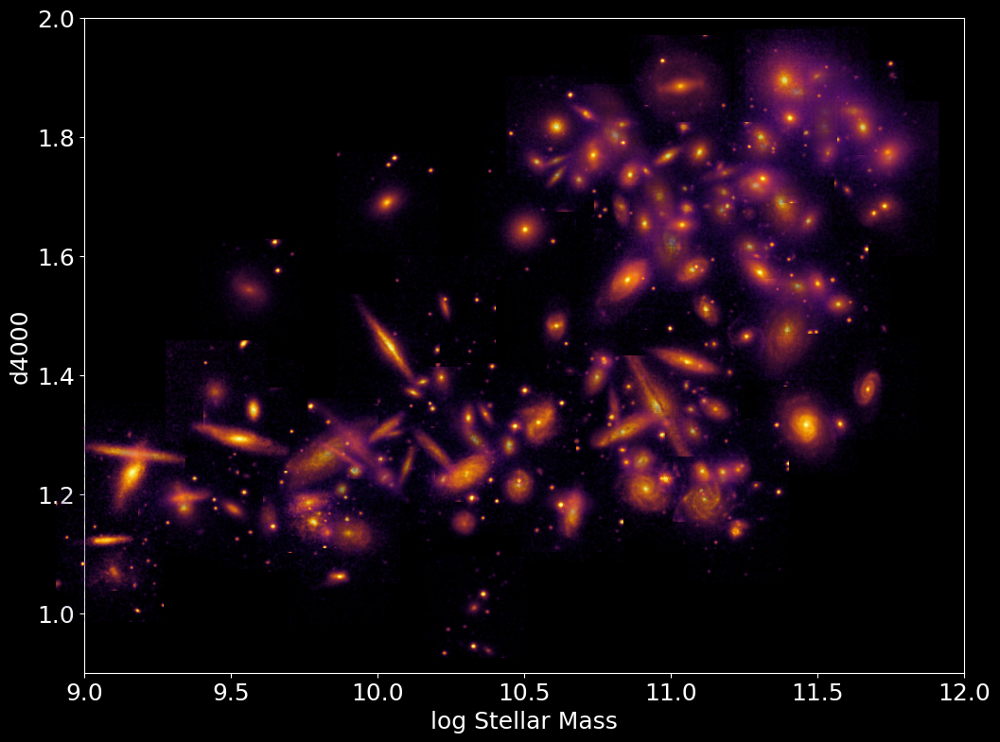

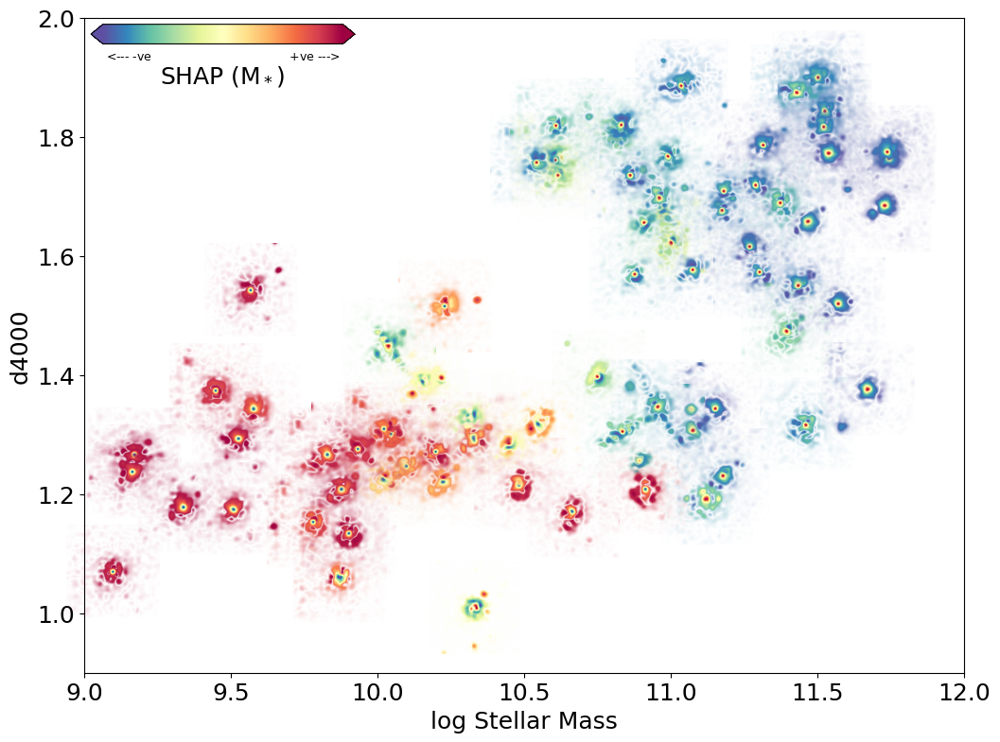

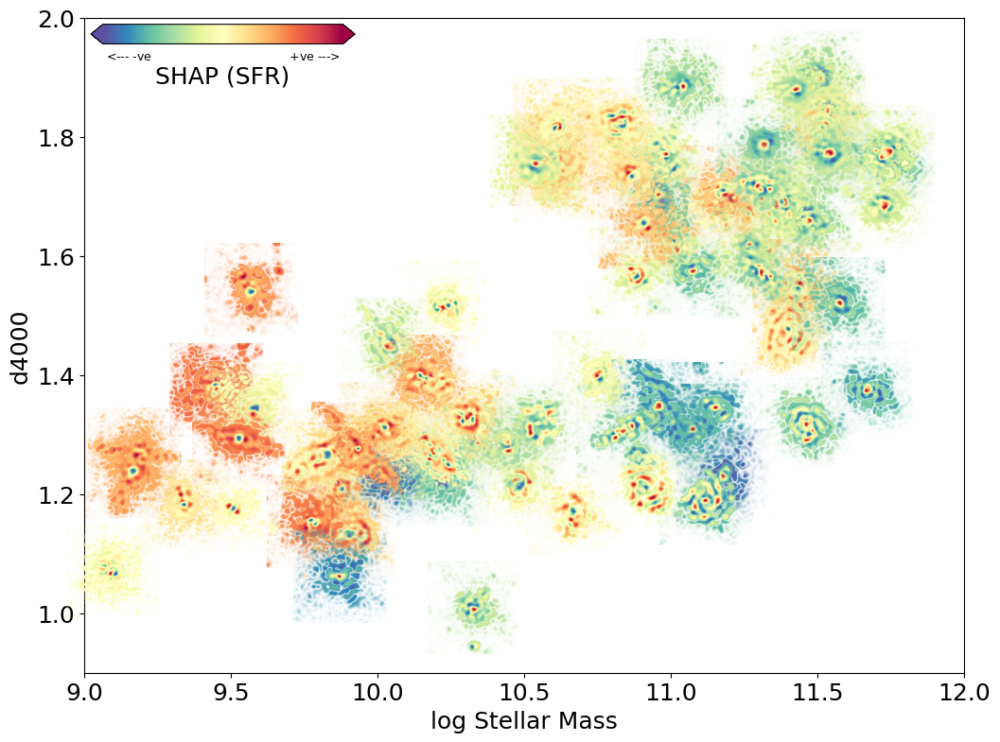

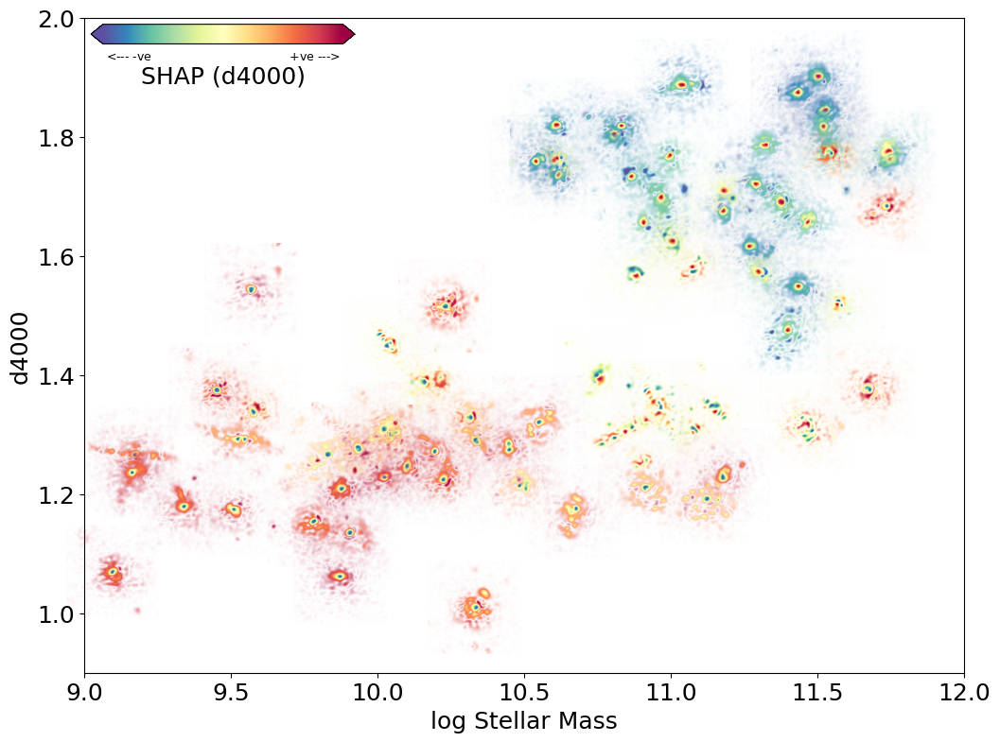

In [11]:
xqty = manga_scalars['log_mstar']
xlabel = 'log Stellar Mass'
yqty = manga_scalars['d4000']
ylabel = 'd4000'
xmin, xmax, ymin, ymax = 9.0, 12., 0.9, 2.0
save_fname = 'figures/mstar_d4000_goodids'

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax], plotim=True, clip=0,
                    mapval = d_im['images'],clabel='M$_*$', save_fname=save_fname+'_galimages')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapmass['shap_map_mass'],clabel='M$_*$', save_fname=save_fname+'_shapmass')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapsfr['shap_map_mass'],clabel='SFR', save_fname=save_fname+'_shapsfr')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapage['shap_map_mass'],clabel='d4000', save_fname=save_fname+'_shapage')


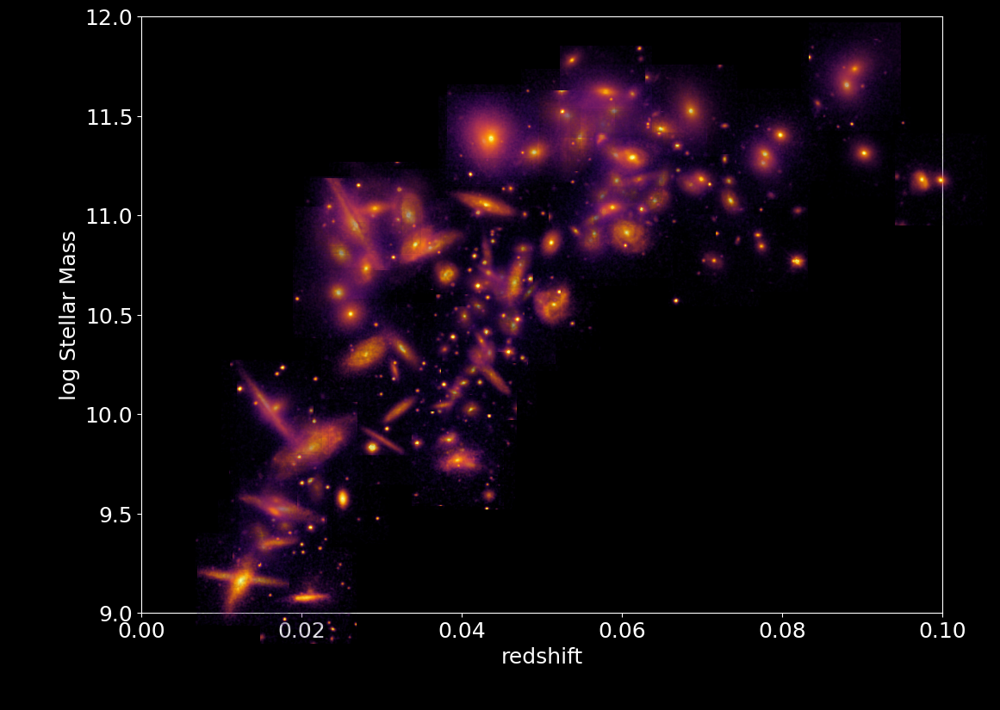

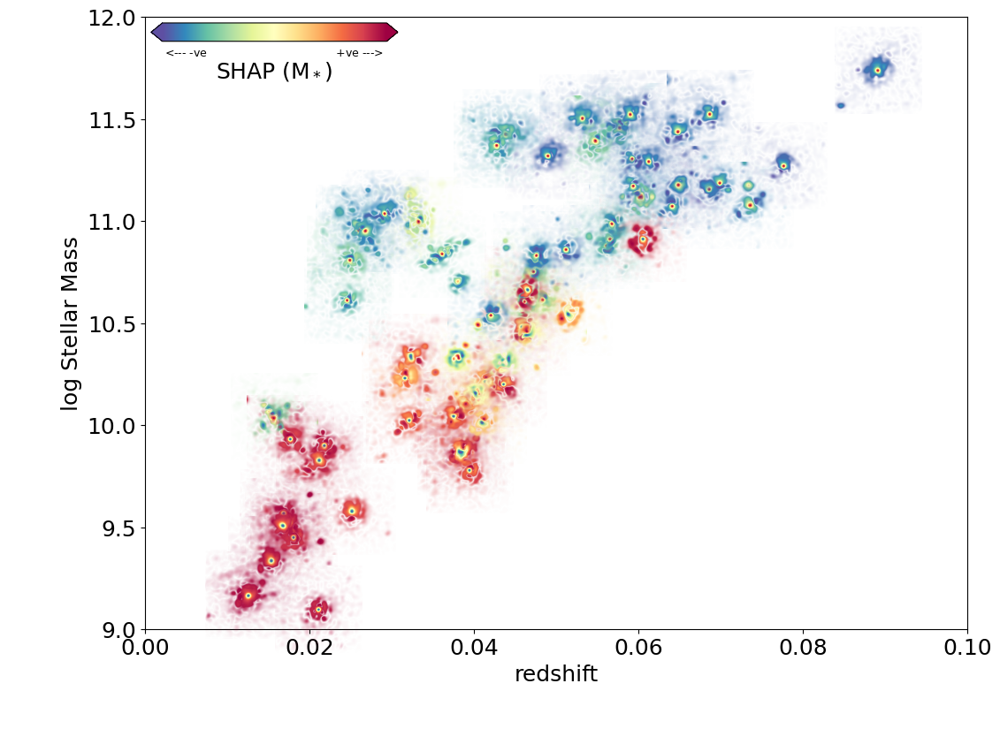

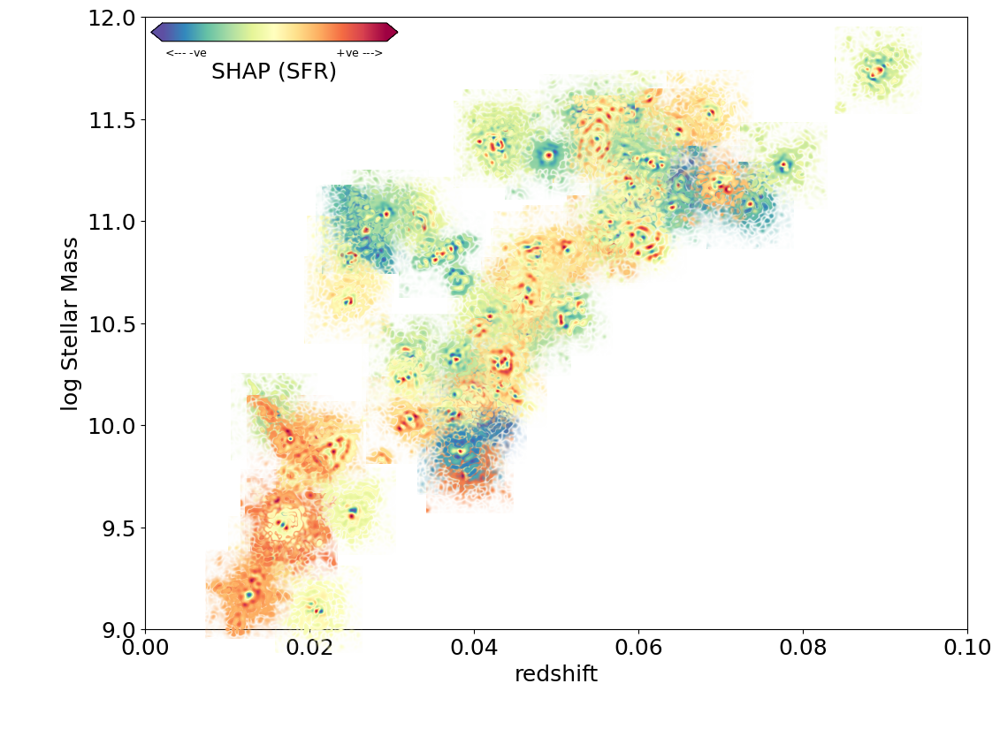

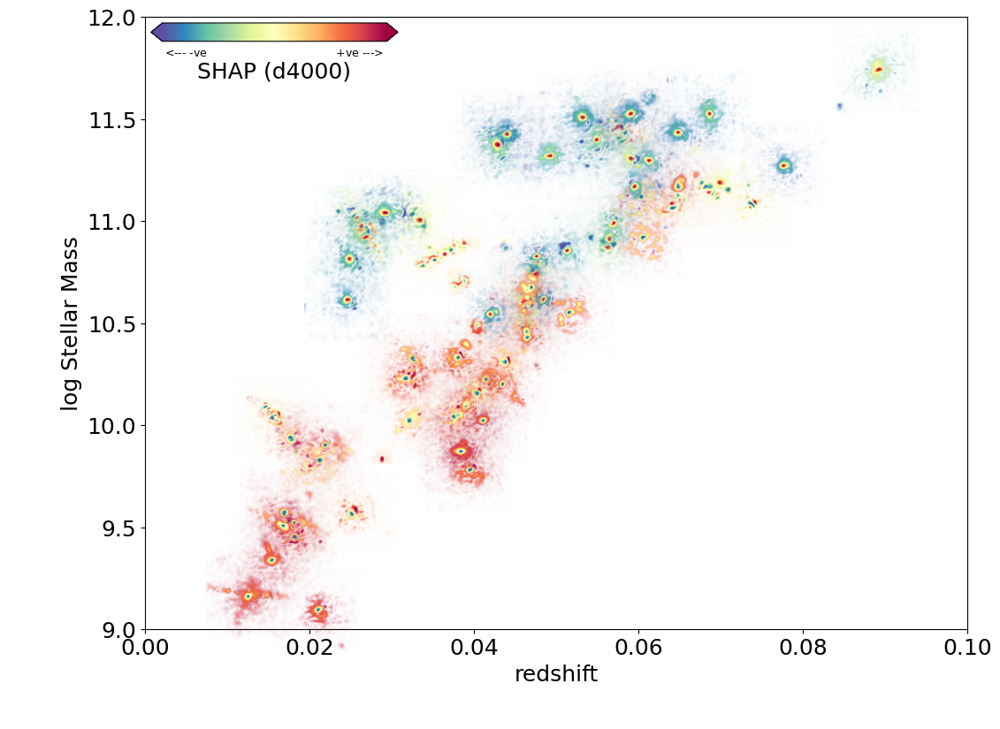

In [12]:
xqty = manga_scalars['redshift']
xlabel = 'redshift'
yqty = manga_scalars['log_mstar']
ylabel = 'log Stellar Mass'
xmin, xmax, ymin, ymax =  0.0,0.1, 9.0, 12.
save_fname = 'figures/redshift_mstar_goodids'

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax], plotim=True, clip=0,
                    mapval = d_im['images'],clabel='M$_*$', save_fname=save_fname+'_galimages')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapmass['shap_map_mass'],clabel='M$_*$', save_fname=save_fname+'_shapmass')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapsfr['shap_map_mass'],clabel='SFR', save_fname=save_fname+'_shapsfr')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapage['shap_map_mass'],clabel='d4000', save_fname=save_fname+'_shapage')


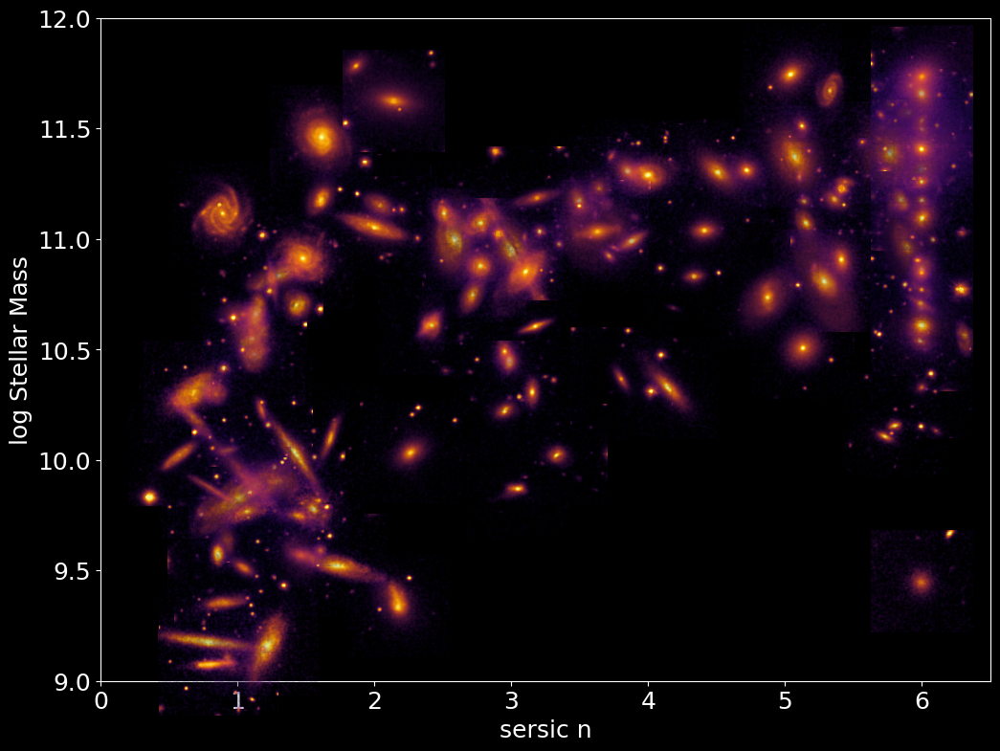

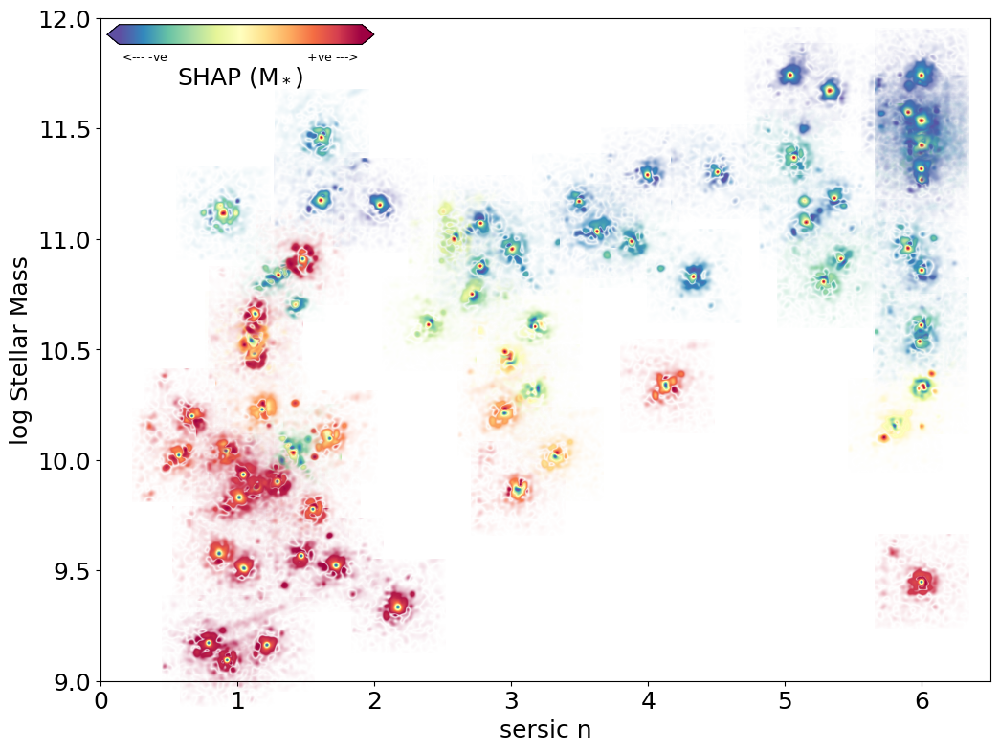

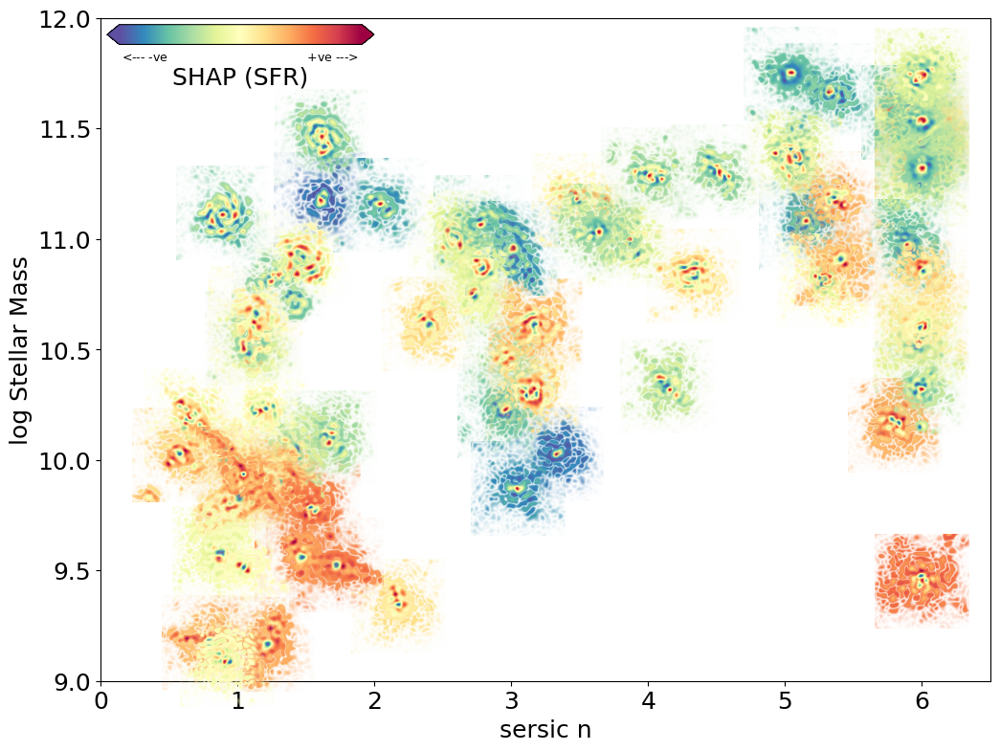

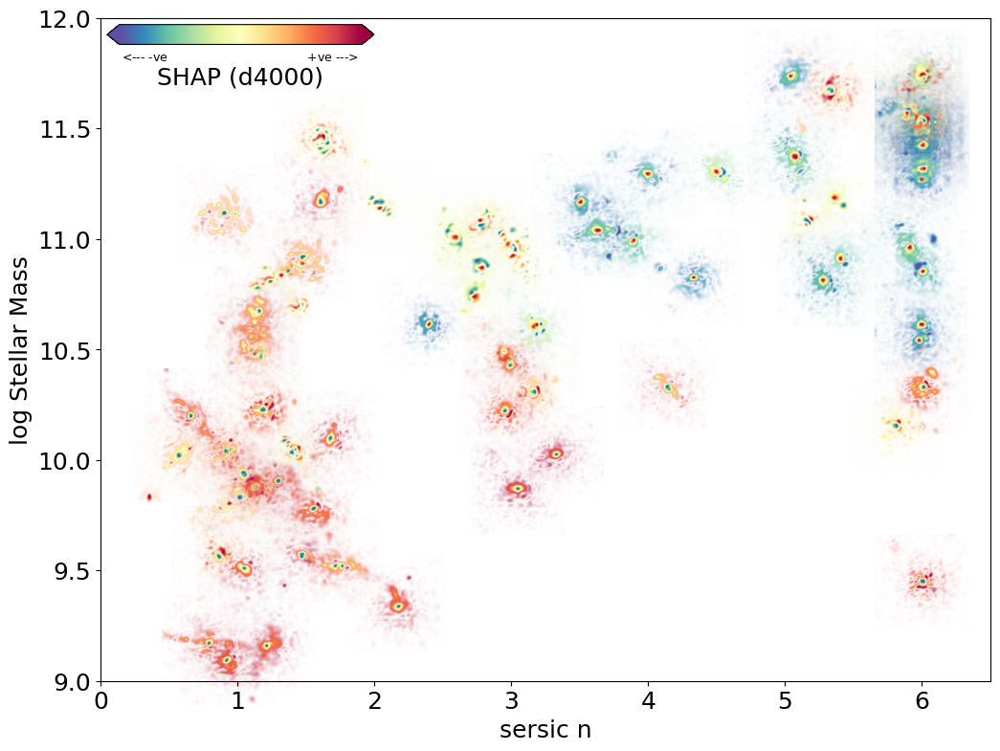

In [13]:
xqty = manga_scalars['sersic_n']
xlabel = 'sersic n'
yqty = manga_scalars['log_mstar']
ylabel = 'log Stellar Mass'
xmin, xmax, ymin, ymax =  0.0,6.5, 9.0, 12.
save_fname = 'figures/sersic_mstar_goodids'

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax], plotim=True, clip=0,
                    mapval = d_im['images'],clabel='M$_*$', save_fname=save_fname+'_galimages')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapmass['shap_map_mass'],clabel='M$_*$', save_fname=save_fname+'_shapmass')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapsfr['shap_map_mass'],clabel='SFR', save_fname=save_fname+'_shapsfr')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapage['shap_map_mass'],clabel='d4000', save_fname=save_fname+'_shapage')


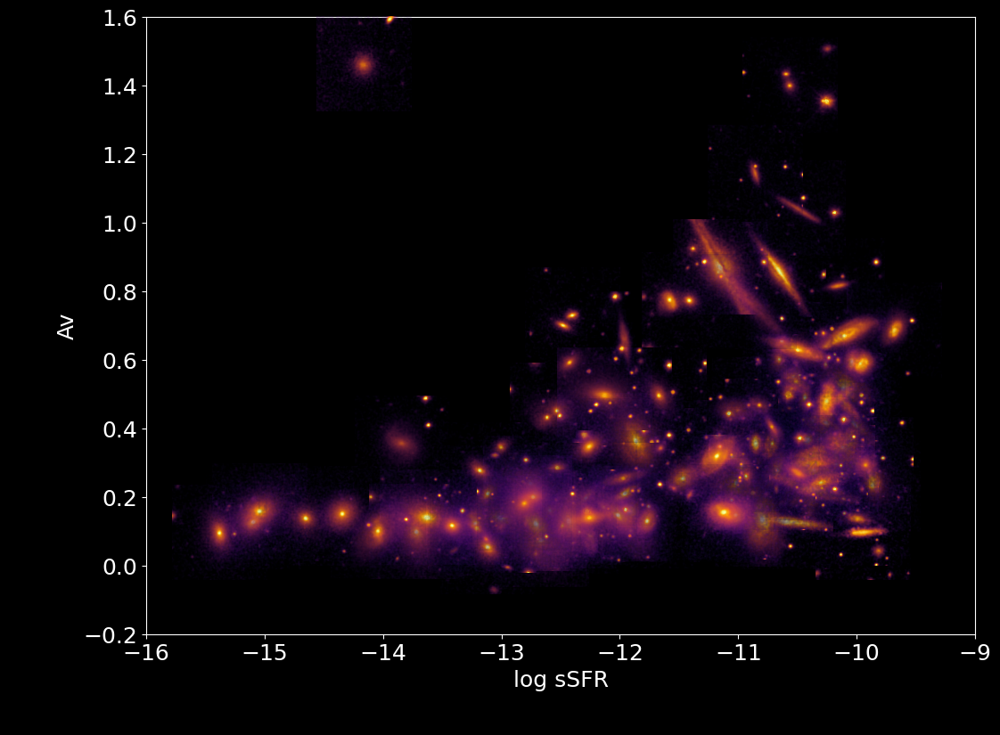

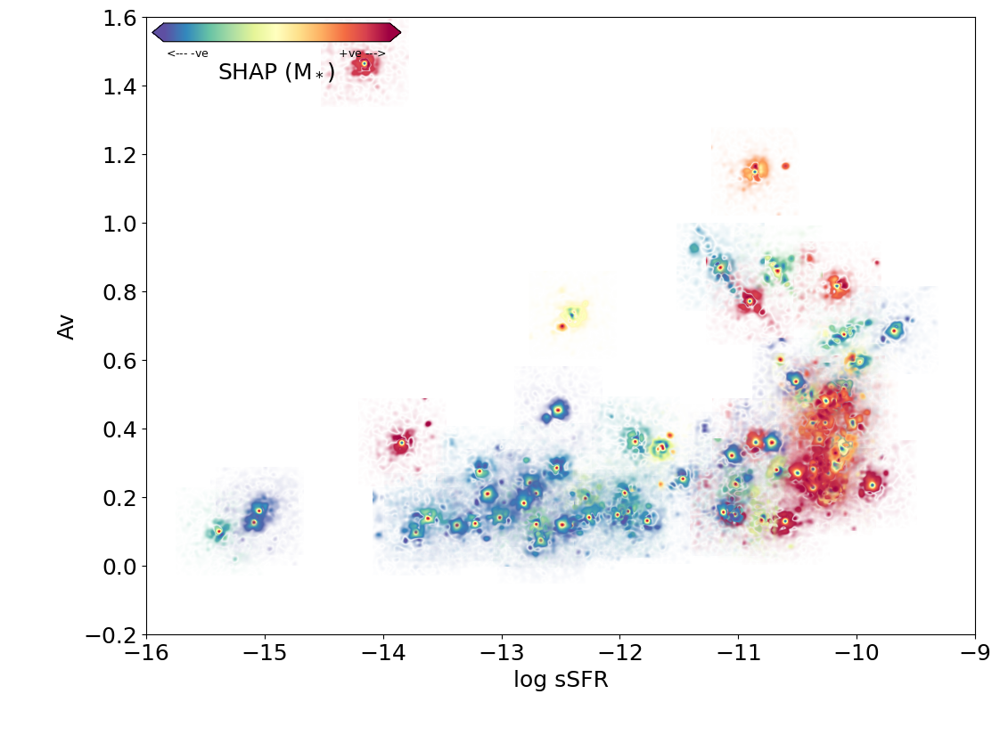

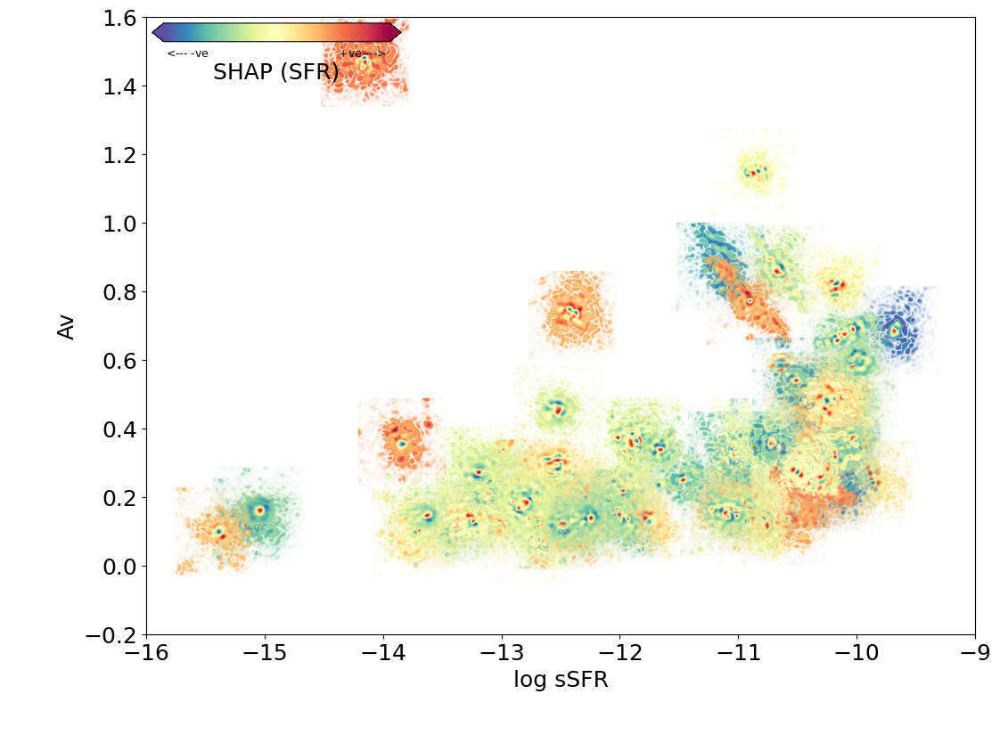

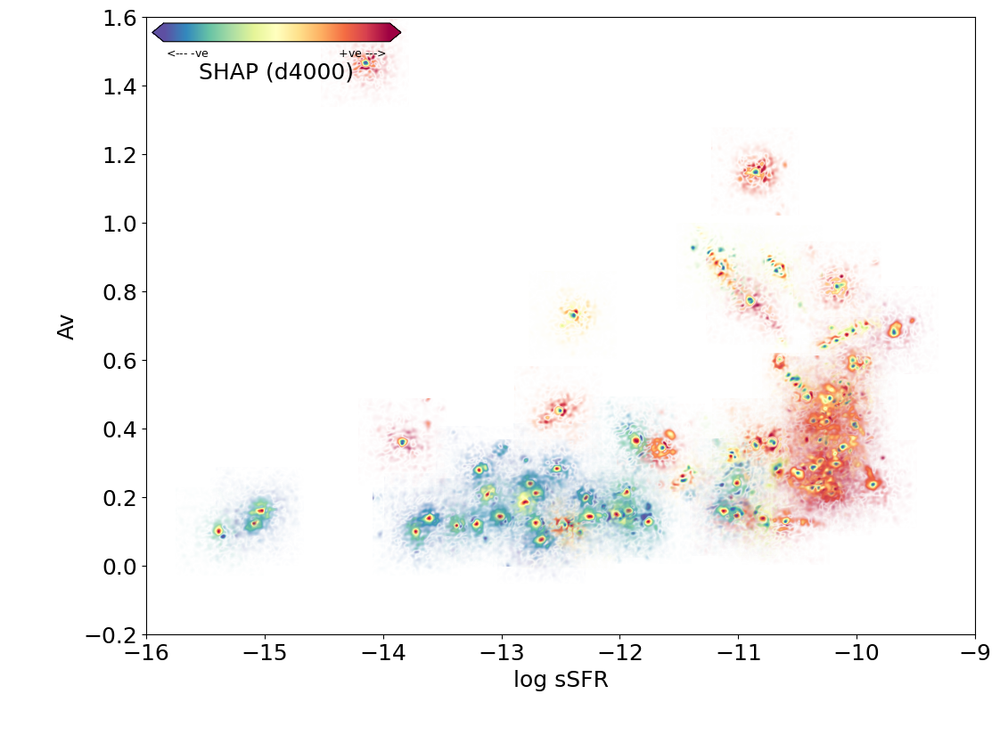

In [14]:
xqty = manga_scalars['log_sfr'] - manga_scalars['log_mstar']
xlabel = 'log sSFR'
yqty = manga_scalars['Av']
ylabel = 'Av'
xmin, xmax, ymin, ymax = -16,-9,-0.2,1.6
save_fname = 'figures/ssfr_av_goodids'

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax], plotim=True, clip=0,
                    mapval = d_im['images'],clabel='M$_*$', save_fname=save_fname+'_galimages')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapmass['shap_map_mass'],clabel='M$_*$', save_fname=save_fname+'_shapmass')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapsfr['shap_map_mass'],clabel='SFR', save_fname=save_fname+'_shapsfr')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapage['shap_map_mass'],clabel='d4000', save_fname=save_fname+'_shapage')


# Plots for a whole lot more galaxies


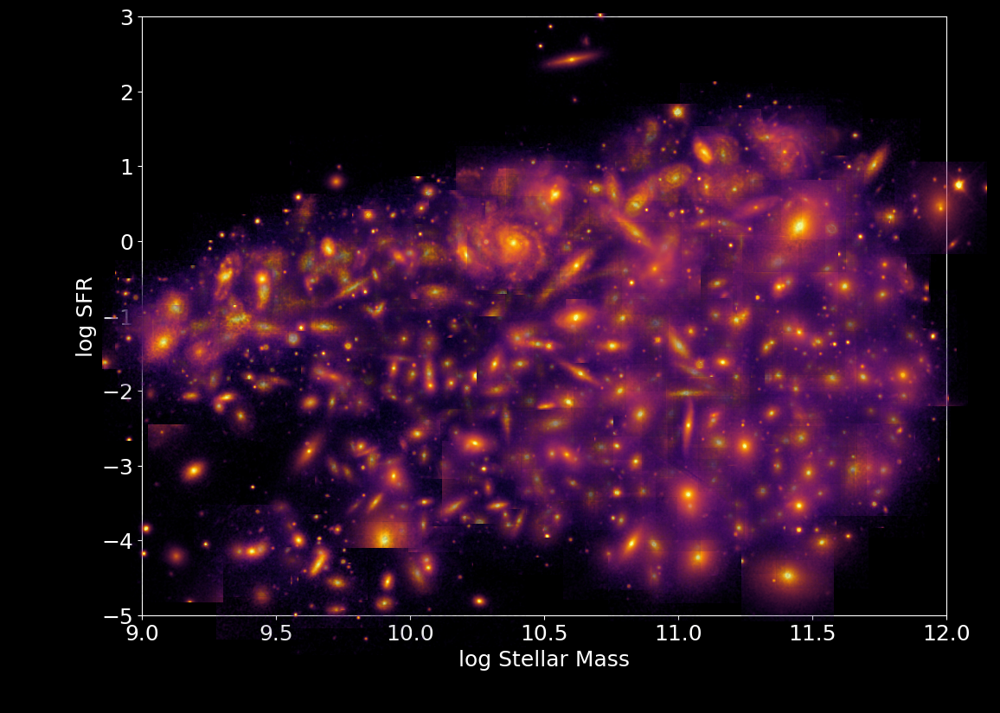

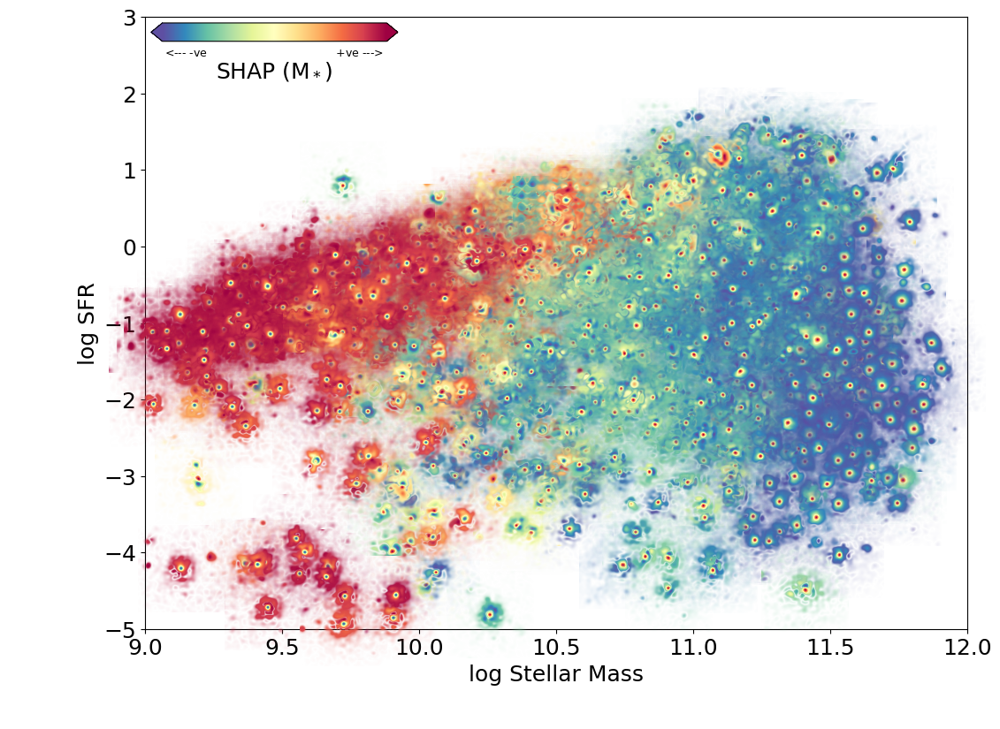

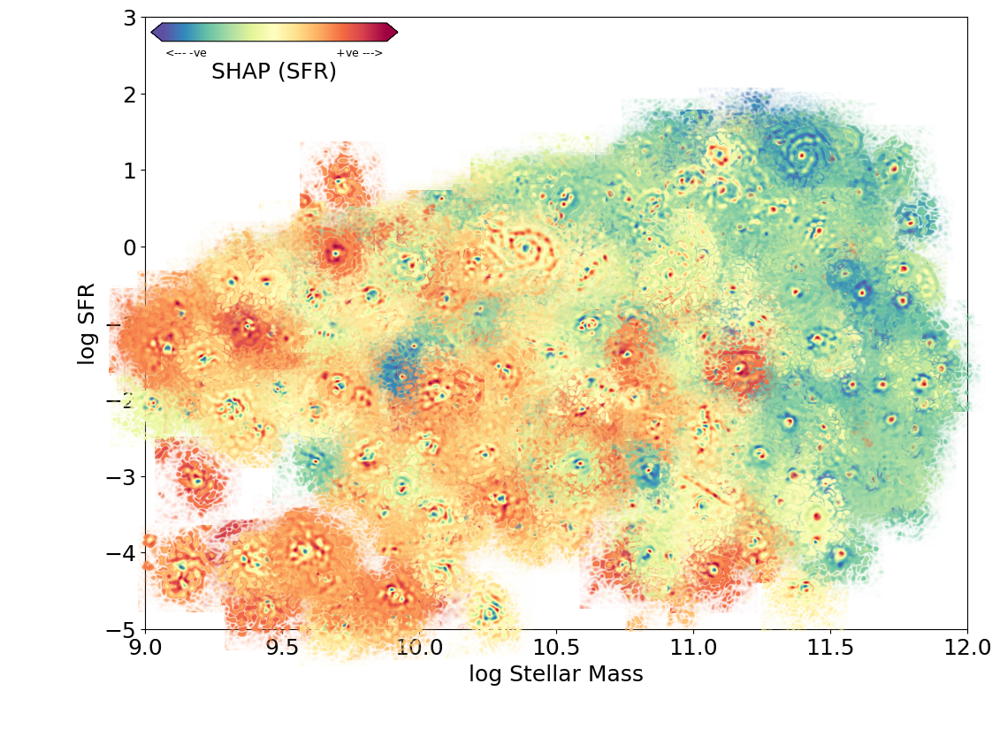

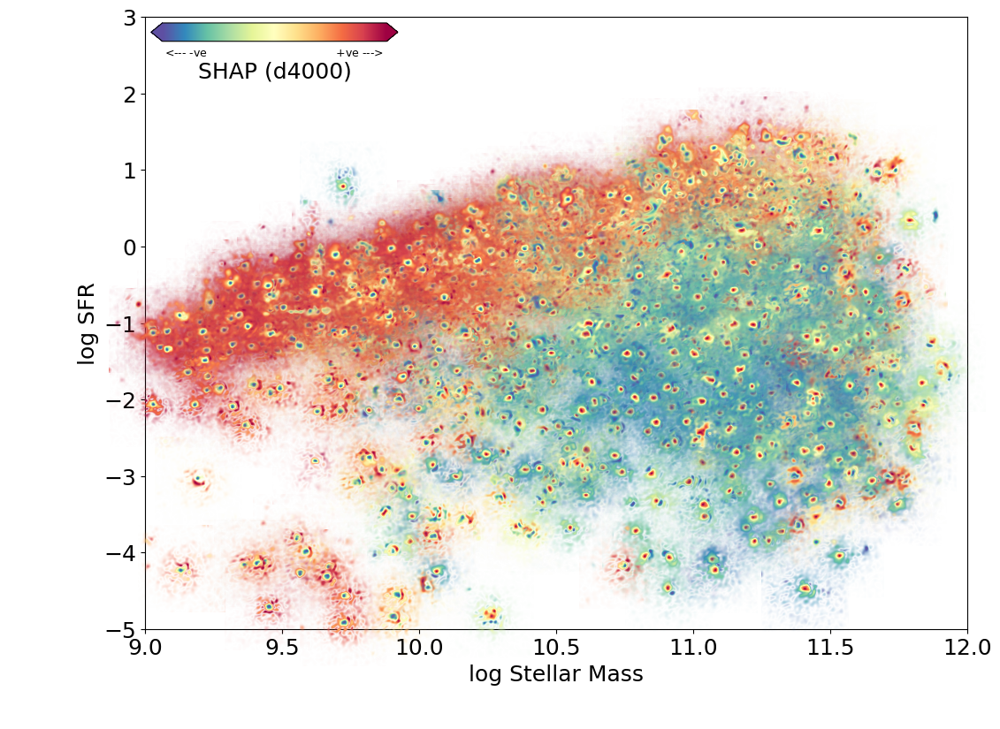

In [20]:
ids = np.arange(1500)

xqty = manga_scalars['log_mstar']
xlabel = 'log Stellar Mass'
yqty = manga_scalars['log_sfr']
ylabel = 'log SFR'
xmin, xmax, ymin, ymax = 9.0, 12., -5. ,3.
save_fname = 'figures/mstar_sfr_n1500'

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax], plotim=True, clip=0,
                    mapval = d_im['images'],clabel='M$_*$', save_fname=save_fname+'_galimages')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapmass['shap_map_mass'],clabel='M$_*$', save_fname=save_fname+'_shapmass')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapsfr['shap_map_mass'],clabel='SFR', save_fname=save_fname+'_shapsfr')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapage['shap_map_mass'],clabel='d4000', save_fname=save_fname+'_shapage')


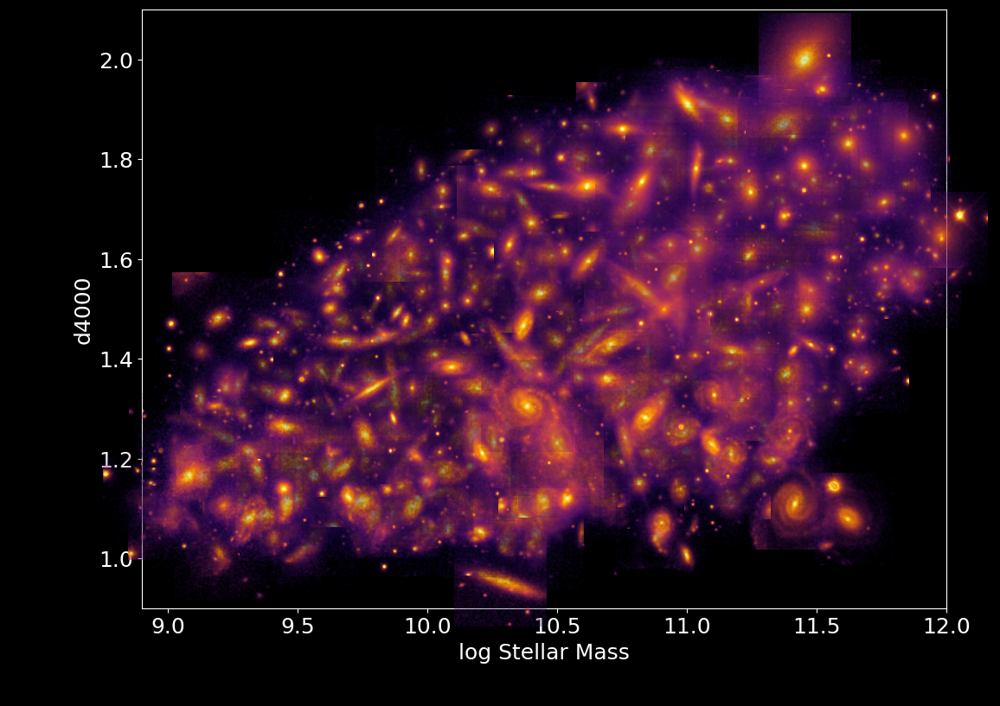

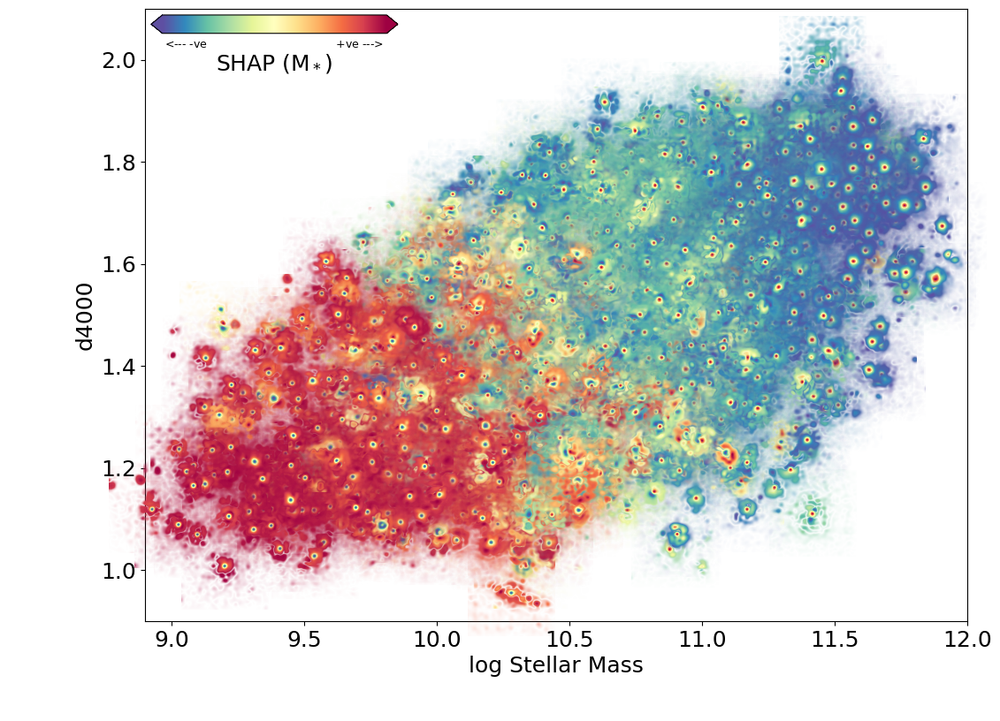

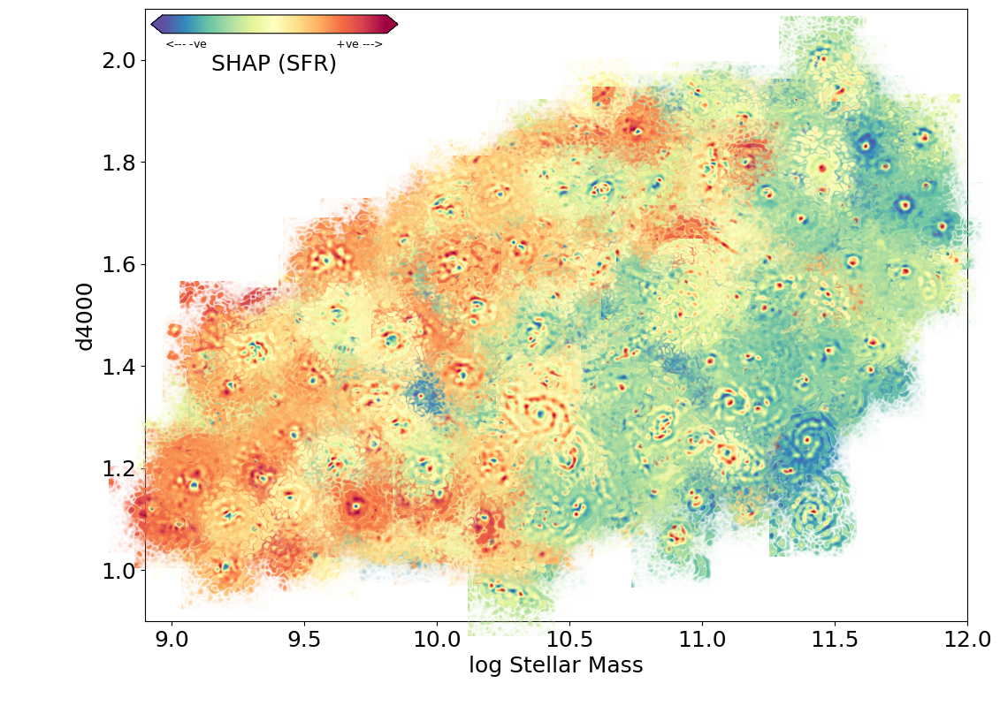

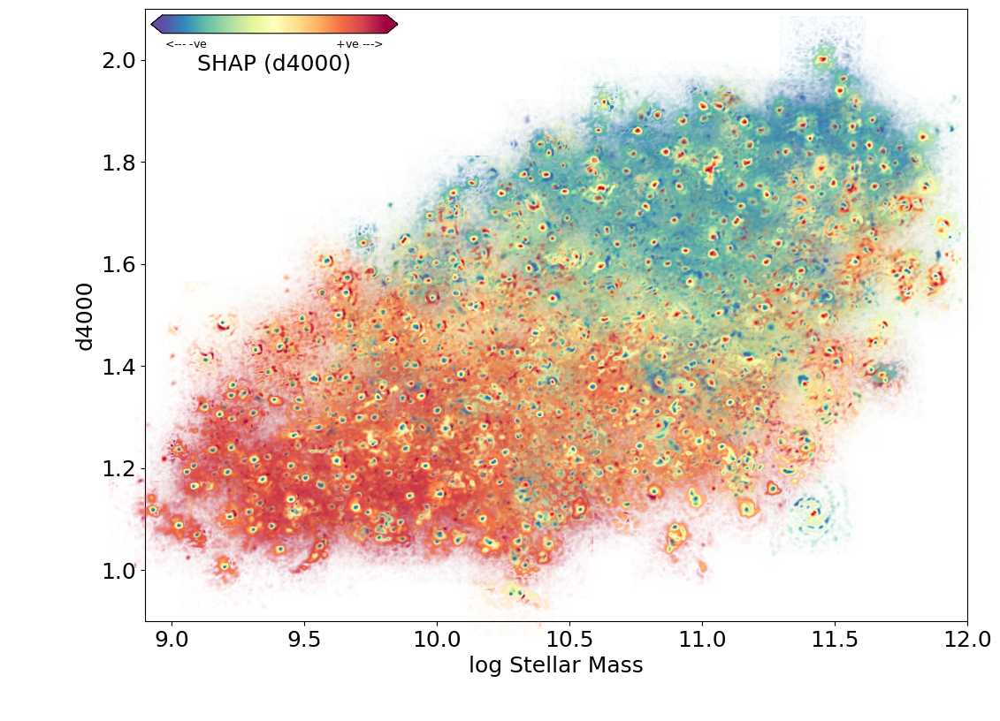

In [17]:
ids = np.arange(1500)

xqty = manga_scalars['log_mstar']
xlabel = 'log Stellar Mass'
yqty = manga_scalars['d4000']
ylabel = 'd4000'
xmin, xmax, ymin, ymax = 8.9, 12, 0.9, 2.1
save_fname = 'figures/mstar_d4000_n1500'

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax], plotim=True, clip=0,
                    mapval = d_im['images'],clabel='M$_*$', save_fname=save_fname+'_galimages')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapmass['shap_map_mass'],clabel='M$_*$', save_fname=save_fname+'_shapmass')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapsfr['shap_map_mass'],clabel='SFR', save_fname=save_fname+'_shapsfr')

make_gal_inset_plots(ids = ids, 
                     xqty = xqty, xlabel=xlabel, 
                     yqty = yqty, ylabel=ylabel, 
                     axisvals = [xmin, xmax, ymin, ymax],
                    mapval = d_shapage['shap_map_mass'],clabel='d4000', save_fname=save_fname+'_shapage')
